In [1]:
%load_ext autoreload
%autoreload 2

import glob, os, sys

import numpy as np
import matplotlib.pyplot as plt

import torch
torch.serialization.add_safe_globals
from torch.utils.data import TensorDataset, DataLoader
from pytorch_networks_convae import *
import argparse
from datasetio import *
import copy
from scaler import *
import time


In [2]:
data_dir = "/plp_scr1/agar_sh/data/TPH/"

[[5], [False], [6], [[True, True]], [16], ['curl'], [10], [False], [16], [0.0], ['newfluidnet'], ['learned'], [2], [5], [1], 'our best model']
82
[[5], [False], [3], [[False, False]], [16], ['curl'], [10], [False], [16], [0.0], ['unet'], ['zeros'], [2], [5], [1], 'unet with same parameter count']
45
[[5], [False], [3], [[False, False]], [64], ['curl'], [10], [False], [16], [0.0], ['unet'], ['zeros'], [2], [5], [1], 'unet with same inference time']
28
[[5], [False], [3], [[True, True]], [6], ['curl'], [10], [False], [16], [0.0], ['unet'], ['learned'], [2], [5], [1], 'unet with same parameter count and our tricks']
137
[[5], [False], [3], [[True, True]], [16], ['curl'], [10], [False], [16], [0.0], ['unet'], ['learned'], [2], [5], [1], 'unet with same inference time and our tricks']
61


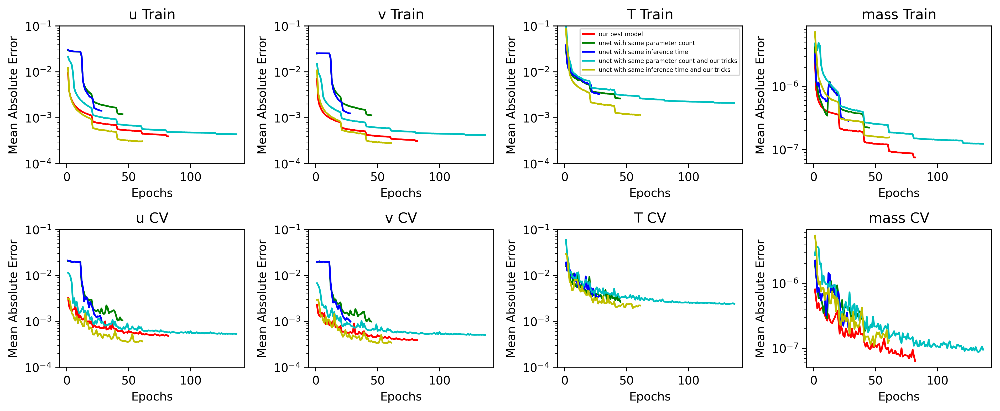

In [3]:
colors = ["r-", "g-", "b-", "c-", "y-", "m-","k-",
          "r.", "g.", "b.", "c.", "y.", "m."] 

NUM_COLORS = 36
cm = plt.get_cmap('gist_rainbow')

para_counts = []
min_mae_u = []
min_mae_v = []
min_mae_p = []
labels = []

debug = False
# kernel, symmetry, layers, loss_scale loss_derivative, filters, "loss", a_bound, blurr, batch size, l2_reg, padding, factor, levels, roll forward
combs = [        

            [[5],   [False],      [6],     [[True,True]],       [16],      ["curl"], [10],   [False], [16], [0.0], ["newfluidnet"], 
             ["learned"], [2], [5], [1], "our best model"],

            [[5],   [False],      [3],     [[False,False]],       [16],      ["curl"], [10],   [False], [16], [0.0], ["unet"], 
             ["zeros"], [2], [5], [1], "unet with same parameter count"],

            [[5],   [False],      [3],     [[False,False]],       [64],      ["curl"], [10],   [False], [16], [0.0], ["unet"], 
             ["zeros"], [2], [5], [1], "unet with same inference time"],

            [[5],   [False],      [3],     [[True,True]],       [6],      ["curl"], [10],   [False], [16], [0.0], ["unet"], 
             ["learned"], [2], [5], [1], "unet with same parameter count and our tricks"],
    
            [[5],   [False],      [3],     [[True,True]],       [16],      ["curl"], [10],   [False], [16], [0.0], ["unet"], 
             ["learned"], [2], [5], [1], "unet with same inference time and our tricks"],
             

             #[[5],   [False],      [3],     [[False,False]],       [16],      ["curl"], [10],   [False], [16], [0.0], ["unet"], 
            # ["zeros"], [2], [5], [4], "unet with same parameter count and roll4"],

            #[[5],   [False],      [3],     [[False,False]],       [64],      ["curl"], [10],   [False], [16], [0.0], ["unet"], 
            # ["zeros"], [2], [5], [4], "unet with same inference time and roll4"],

            #[[5],   [False],      [3],     [[True,True]],       [6],      ["curl"], [10],   [False], [16], [0.0], ["unet"], 
            # ["learned"], [2], [5], [4], "unet with same parameter count and our tricks and roll4"],
    
            #[[5],   [False],      [3],     [[True,True]],       [16],      ["curl"], [10],   [False], [16], [0.0], ["unet"], 
            # ["learned"], [2], [5], [4], "unet with same inference time and our tricks and roll4"],
            
        ]


fig = plt.figure(figsize=(12,5),dpi=320)
ax = {}
cntr = 0
for k in range(8):
    ax[cntr] = fig.add_subplot(2,4,cntr+1)
    ax[cntr].set_prop_cycle('color', [cm(1.*i/NUM_COLORS) for i in range(NUM_COLORS)])
    cntr += 1
counter = 0
for comb in combs:
    print(comb)
    
    act_fn = "gelu"
    dilation = 1
    use_skip = False
    blurr = False
    d_r = 0.0
    p_pred = False
    advect = False

    for ker in comb[0]: 
        for sym in comb[1]:
            for rep in comb[2]:
                for loss_scale, loss_derivative in comb[3]:
                    for fil in comb[4]:
                        for loss_type in comb[5]:
                            for a_bound in comb[6]:
                                for blurr in comb[7]:
                                    for batch_size in comb[8]:
                                        for l2 in comb[9]:
                                            for network in comb[10]:
                                                for r_p in comb[11]:
                                                    for factor in comb[12]:
                                                        for levels in comb[13]:
                                                            for roll_forward in comb[14]:
                                                            
                                                                bbatch_size = batch_size
                                                                lev = levels
                                                                reps = rep
                                                                                                                   
    
                                                                r_pp = r_p
                                                                symm = sym
                                                                f_nn =  network + "_levels_" + str(lev) + "_" + act_fn + \
                                                                        "_" + str(fil) + "_" + r_pp + "_" + loss_type + \
                                                                        "_" + str(symm) + "_ab" + str(a_bound) + "_b" + str(bbatch_size) + \
                                                                        "_r" + str(reps) + "_k" + str(ker) + "_fa" + str(factor) + \
                                                                        "_ad" + str(advect) + "_p_pred" + str(p_pred) +\
                                                                        "_l2" + str(l2) + "_l_sc" + str(loss_scale) +\
                                                                        "_l_de" + str(loss_derivative) + "_deb" + str(debug)
                                                                if network == "unet":
                                                                    f_nn += "_roll" + str(roll_forward) + "_new"
                                                                    
                    
                                                                if blurr:
                                                                    f_nn += "_blurr"
                                                                
                                                                layers = []
                                                                loss_layer = []
                                                                loss_cv_layer = []
                                                                nn_dir = "/plp_user/agar_sh/PBML/pytorch/TPH/CONVNN/trained_networks/"
                                                                nn_dir = nn_dir + f_nn + "/"
                                                                            
                                                                with open(nn_dir + "fluidnet_uvpT.txt") as fw:
                                                                    lines = fw.readlines()
                                                                fw.close()
                                                                loss_u       = []
                                                                loss_v       = []
                                                                loss_p       = []
                                                                loss_mass    = []
                                                                loss_cv_u    = []
                                                                loss_cv_v    = []
                                                                loss_cv_p    = []
                                                                loss_cv_mass = []
                                                                
                                                                for l in lines[1:]:
                                                                    ll    = l[l.index("[")+1:l.index("],[")].split(",")
                                                                    l_r   = l[l.index("],[")+3:]
                                                                    ll_cv = l_r[:l_r.index("],")].split(",")                   
                                                            
                                                                    loss_u.append([float(ll[0])])
                                                                    loss_v.append([float(ll[1])])
                                                                    loss_p.append([float(ll[3])])    
                                                                    loss_mass.append([float(ll[4])+1e-16])
                                                                    
                                                                    loss_cv_u.append([float(ll_cv[0])])
                                                                    loss_cv_v.append([float(ll_cv[1])])
                                                                    loss_cv_p.append([float(ll_cv[3])])
                                                                    loss_cv_mass.append([float(ll_cv[4])+1e-16])
                                                            
                                                                #layers.append(int(f_nn[-1]))
                                                                #loss_layer.append([min(loss_u), min(loss_v), min(loss_p)])
                                                                #loss_cv_layer.append([min(loss_cv_u), min(loss_cv_v), min(loss_cv_p)])
                                            
                                                                label = comb[-1]
                                                                
                                                                iterations = np.arange(1,len(loss_u)+1)
                                                                print(iterations[-1])
    
                                                                style="" #"-" if "our tricks" in label else ""
                                                                ax[0].plot(iterations, loss_u, colors[counter]+style, label=label)
                                                                ax[1].plot(iterations, loss_v, colors[counter]+style, label=label)
                                                                ax[2].plot(iterations, loss_p, colors[counter]+style, label=label)
                                                                ax[3].plot(iterations, loss_mass, colors[counter]+style, label=label)
                                                                
                                                                ax[4].plot(iterations, loss_cv_u, colors[counter]+style, label=label)
                                                                ax[5].plot(iterations, loss_cv_v, colors[counter]+style, label=label)
                                                                ax[6].plot(iterations, loss_cv_p, colors[counter]+style, label=label)
                                                                ax[7].plot(iterations, loss_cv_mass, colors[counter]+style, label=label)
                                            
                                                                counter += 1  
                                            
                                                                #para_counts.append(get_model_parameters(fil, rep, ker, sym))
                                                                #min_mae_u.append(min(loss_cv_u))
                                                                #min_mae_v.append(min(loss_cv_v))
                                                                #min_mae_p.append(min(loss_cv_p))
                                                                #labels.append(label)


for var_ind, var in enumerate(["u", "v", "T", "mass"]):
    ax[var_ind].set_title(var + " Train")
    ax[var_ind+4].set_title(var + " CV")
    ax[var_ind].set_ylabel("Mean Absolute Error")
    ax[var_ind+4].set_ylabel("Mean Absolute Error")
    ax[var_ind].set_xlabel("Epochs")
    ax[var_ind+4].set_xlabel("Epochs")
                                    
for ax_ind in range(8):
    ax[ax_ind].set_yscale("log")
    
    if ax_ind in [0,1,2,4,5,6]:
        if not debug:
            ax[ax_ind].set_ylim([1e-4,1e-1])
    #ax[ax_ind].set_xscale("log")
    #if ax_ind != 3 and ax_ind != 7:
        #ax[ax_ind].set_ylim([10,500])
        #ax[ax_ind].set_xlim([0, 20])
ax[2].legend(prop={'size': 5})
#ax[6].legend(prop={'size': 4})
plt.tight_layout()
plt.show()

In [4]:
#gpu_number = 1
#device = torch.device("cuda:" + str(gpu_number)) if torch.cuda.is_available() else torch.device("cpu")
device = torch.device("cpu")

act_fn = "gelu"
levels = 5

network = "unet"
c_h    = 16
epoch  = 59
loss_scale = True
loss_derivative = True
r_p    = "learned"

repeats = 3
blurr = False
debug = False
batch_size = 16
roll_forward = 1

factor = 2
l2 = 0.0
d_r = 0.0
loss_type = "curl"
dilation = 1
use_symm = False 
a_bound  = 10
kernel = 5
use_skip = False
scale = True
p_pred = False
noise = 0.0

advect = False
spectral_conv = False

nn_dir = "/plp_user/agar_sh/PBML/pytorch/TPH/CONVNN/trained_networks/"
f_nn   =    network + "_levels_" + str(levels) + "_" + act_fn + \
            "_" + str(c_h) + "_" + r_p + "_" + loss_type +  \
            "_" + str(use_symm) + "_ab" + str(a_bound) + "_b" + str(batch_size) + \
            "_r" + str(repeats) + "_k" + str(kernel) + "_fa" + str(factor) + \
            "_ad" + str(advect) + "_p_pred" + str(p_pred) + \
            "_l2" + str(l2) + "_l_sc" + str(loss_scale) + \
            "_l_de" + str(loss_derivative) + "_deb" + \
            str(debug) + "_roll" + str(roll_forward) + "_new"

nn_dir = nn_dir + f_nn + "/"
print(nn_dir)
if network=="fluidnet":
    c_i = 7
    c_o = 3
elif network == "ifluidnet":
    c_i = 9
    c_o = 3
elif network == "convae":
    c_i = 3
    c_o = 3
elif network == "unet":
    c_i = 11
    c_o = 4
    if not p_pred:
        c_i -= 1

if loss_type == "curl":
    c_o -= 1
if not p_pred:
    c_o -= 1

if network == "unet":
    model_uvp = Unet(levels, c_i, c_h, c_o, device, act_fn, r_p, loss_type, 
                         use_symm=use_symm, dilation=dilation, a_bound=a_bound,
                         repeats=repeats, use_skip=use_skip, f=kernel, p_pred=p_pred).double()
    ts = 1
    ts_net = TS(model_uvp, ad=None, device=device, ts=ts, advection_scheme=0, 
                scale=scale, p_pred=p_pred, net=network).double().to(device)

print(count_parameters(model_uvp))


if debug:
    model_uvp.load_state_dict(torch.load(nn_dir + "fluidnet_uvp.pt", map_location=device))
else:
    model_uvp.load_state_dict(torch.load(nn_dir + str(epoch) + "_fluidnet_uvp.pt", map_location=device))

torch.compile(model_uvp)
model_uvp.eval()

/plp_user/agar_sh/PBML/pytorch/TPH/CONVNN/trained_networks/unet_levels_5_gelu_16_learned_curl_False_ab10_b16_r3_k5_fa2_adFalse_p_predFalse_l20.0_l_scTrue_l_deTrue_debFalse_roll1_new/
18651378


/tmp/ipykernel_2374242/4277595829.py:83: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model_uvp.load_state_dict(torch.load(nn_dir + str(epoch) + "_fluidnet_uvp.pt", map_loc

Unet(
  (conv): ModuleList(
    (0): FluidLayer(
      (layers): ModuleList(
        (0): BoundaryLearnedConvolution2D(
          (conv): Conv2d(10, 16, kernel_size=(5, 5), stride=(1, 1), padding=valid, bias=False)
          (conv_top_left): Conv2d(10, 16, kernel_size=(5, 5), stride=(1, 1), padding=valid, bias=False)
          (conv_top_right): Conv2d(10, 16, kernel_size=(5, 5), stride=(1, 1), padding=valid, bias=False)
          (conv_bottom_left): Conv2d(10, 16, kernel_size=(5, 5), stride=(1, 1), padding=valid, bias=False)
          (conv_bottom_right): Conv2d(10, 16, kernel_size=(5, 5), stride=(1, 1), padding=valid, bias=False)
          (conv_top): Conv2d(10, 16, kernel_size=(5, 5), stride=(1, 1), padding=valid, bias=False)
          (conv_bottom): Conv2d(10, 16, kernel_size=(5, 5), stride=(1, 1), padding=valid, bias=False)
          (conv_left): Conv2d(10, 16, kernel_size=(5, 5), stride=(1, 1), padding=valid, bias=False)
          (conv_right): Conv2d(10, 16, kernel_size=(5, 5), s

In [5]:
roll_forward = 32

sims = torch.load(data_dir + "/sims.pt", weights_only=False)
examine_intermediate = False

a_min = []
a_max = []
u_min = []
u_max = []
v_min = []
v_max = []


for an in ["test"]:
    x_list = []
    y_list = []
    total_samples = 0
    
    for si, sim in enumerate(sims):
        ignr, ignr, raq, fkt, fkp, gr, ar, ignr = sim
        if sim[1] == an and raq in [8.75081696]: #0.526931, 6.79733173, 3.66563052]: 
            print(tabulate([["num", "dataset", "raq", "fkt", "fkp", "gr", "ar"],
                            sim[:-1]
                           ]))

            py_dir = data_dir + "/" + sim[1] + "/sim_" + str(sim[0])
                
            raq_nd = torch.tensor((raq-0.12624371)/(9.70723344-0.12624371), dtype=torch.float64)
            fkt_nd = torch.tensor((np.log10(fkt)-6.00352841978384)/(
                9.888820429862925-6.00352841978384), dtype=torch.float64)
            fkp_nd = torch.tensor((np.log10(fkp)-0.005251646002323797)/(
                1.9927988938926755-0.005251646002323797), dtype=torch.float64)

            fkt = torch.tensor(fkt, dtype=torch.float64)
            fkp = torch.tensor(fkp, dtype=torch.float64)
            
            xcc    = torch.load(py_dir + "/xc.pt", weights_only=False)
            ycc    = torch.load(py_dir + "/yc.pt", weights_only=False)
            xcc    = xcc.view(1,1,xcc.shape[0],xcc.shape[1])
            ycc    = ycc.view(1,1,ycc.shape[0],ycc.shape[1])

            if network=="newfluidnet":
                xcc[:,:,:,0]  = 0.0
                xcc[:,:,:,-1] = 4.0
                ycc[:,:,0,:]  = 0.0
                ycc[:,:,-1,:] = 1.0

            take_every = 1

            u  = torch.load(py_dir + "/e" + str(take_every) + "_uprev_data.pt", weights_only=False)
            v  = torch.load(py_dir + "/e" + str(take_every) + "_vprev_data.pt", weights_only=False)

            if p_pred:
                p  = torch.load(py_dir + "/e" + str(take_every) + "_pprev_data.pt", weights_only=False)
                
            Tprev = torch.load(py_dir + "/e" + str(take_every) + "_Tprev_data.pt", weights_only=False)
            times = torch.load(py_dir + "/times.pt", weights_only=False)
            dt    = (times[1:] - times[:-1])[::take_every]

            i_vec = [0, int(u.shape[0]/10)]
            scaler = torch.exp((raq/10)*1.80167667 + torch.log(fkt)*0.4330392 + torch.log(fkp)*-0.46052953 )*5  

            
            for i in i_vec: # fix this to include roll forward
                T_pred = Tprev[i:i+1,...]
                u_pred = u[i:i+1,...]/scaler
                v_pred = v[i:i+1,...]/scaler
                dt = torch.tensor((times[i+roll_forward]-times[i])/roll_forward, 
                                  dtype=torch.float64).expand(1,1,u_pred.shape[-2],u_pred.shape[-1])
                    
                t0 = time.time()
                with torch.no_grad():
                    for rf in range(roll_forward):
                        T_preds, _, u_pred,v_pred,p_pred,V = ts_net(T_pred, None, None, ycc, raq_nd, fkt_nd, fkp_nd, 
                                                                    raq, fkt, fkp, xcc, ycc, u_pred, v_pred, dt)
                        u_pred = u_pred.view(1,1,128,506)
                        v_pred = v_pred.view(1,1,128,506)
                        T_pred = T_preds[1].view(1,1,128,506)
                t1 = time.time()
                print("Inference took: " + str(t1-t0))
                
                
                y      = torch.cat((u[i+roll_forward:i+roll_forward+1,...],
                                    v[i+roll_forward:i+roll_forward+1,...],
                                    Tprev[i+roll_forward:i+roll_forward+1,...]), axis=1)
                y_base = torch.cat((u[i+roll_forward-1:i+roll_forward,...],
                                    v[i+roll_forward-1:i+roll_forward,...],
                                    Tprev[i+roll_forward-1:i+roll_forward,...]), axis=1)
                y_pred = torch.cat((u_pred,v_pred,T_pred), axis=1)

                y[:,0:1,...]      = scale_var(y[:,0:1,...], raq, fkt, fkp, "uprev") 
                y[:,1:2,...]      = scale_var(y[:,1:2,...], raq, fkt, fkp, "vprev") 
                y_base[:,0:1,...] = scale_var(y_base[:,0:1,...], raq, fkt, fkp, "uprev") 
                y_base[:,1:2,...] = scale_var(y_base[:,1:2,...], raq, fkt, fkp, "vprev") 
                
                var = ["u", "v", "T", "mass"]
                levels = 16
                
                fig = plt.figure(figsize=(24,3*len(var)),dpi=640)
                ax = {}
                cntr = 0
                for var_ind in range(len(var)):
                    for k in range(3):
                        ax[cntr] = fig.add_subplot(len(var),3,cntr+1)
                        cntr += 1

                figb = plt.figure(figsize=(24,3*(len(var)-1)),dpi=640)
                axb = {}
                cntr = 0
                for var_ind in range(len(var)-1):
                    for k in range(4):
                        axb[cntr] = figb.add_subplot(len(var)-1,4,cntr+1)
                        cntr += 1

                cntr = 0
                for var_ind in range(len(var)):  
                    if var[var_ind] == "mass":
                        u_s_t = y[:,0:1,...]
                        v_s_t = y[:,1:2,...]
                        u_s_p = y_pred[:,0:1,...]
                        v_s_p = y_pred[:,1:2,...]
                        
                        z_t   = dx_center(u_s_t.to(device),device)[...,1:-1,:] + dy_center(
                                                        v_s_t.to(device),device)[...,:,1:-1]
                        z_p   = dx_center(u_s_p.to(device),device)[...,1:-1,:] + dy_center(
                                                        v_s_p.to(device),device)[...,:,1:-1]
                        z_t   = z_t.cpu().detach().numpy()#[...,1:-1,1:-1]
                        z_b   = z_t
                        z_p   = z_p.cpu().detach().numpy()#[...,1:-1,1:-1]
                        xc    = copy.copy(xcc[...,1:-1,1:-1])
                        yc    = copy.copy(ycc[...,1:-1,1:-1])
                        levels = 16
                    else:
                        z_b = y_base[:,var_ind,...].cpu().detach().numpy()
                        z_t = y[:,var_ind,...].cpu().detach().numpy()
                        z_p = y_pred[:,var_ind,...].cpu().detach().numpy()
                        xc    = copy.copy(xcc)
                        yc    = copy.copy(ycc)
                        
                        vmin = z_t.min()
                        vmax = z_t.max()
                        levels = np.linspace(vmin,vmax,16)
                        
                    mae_pred = np.mean(np.abs(z_t-z_p))
                    mae_base = np.mean(np.abs(z_t-z_b))
                    print(i)
                    print("mae prediction " + str(var[var_ind]) + "    : " + str(mae_pred))
                    print("mae baseline " + str(var[var_ind]) + "      : " + str(mae_base))

                    print("baseline/prediction : " + str(mae_base/mae_pred))
                    print()

                    cax = ax[cntr].tricontour(xc.flatten(), yc.flatten(), z_t.flatten(),
                                         levels=levels)
                    ax[cntr].set_title("True " + var[var_ind])
                    cntr += 1
                    fig.colorbar(cax)
                    
                    cax = ax[cntr].tricontour(xc.flatten(), yc.flatten(), z_p.flatten(),
                                         levels=levels)
                    ax[cntr].set_title("Prediction")
                    cntr += 1
                    fig.colorbar(cax)

                    #diff = np.log10(np.abs(z_t-z_p)/np.abs(z_t+1e-16) + 1e-16)
                    diff = (z_t-z_p)/(np.amax(abs(z_t)))*100
                    cax = ax[cntr].tricontourf(xc.flatten(), yc.flatten(), diff.flatten(),
                                         levels=16) #np.linspace(-0.01,0.01,16))
                    ax[cntr].set_title("Difference/Maximum %")
                    cntr += 1
                    fig.colorbar(cax)

                    if var[var_ind] != "mass":
                        axb[0+4*var_ind].plot(z_t[0,0,:], 'b-', label="left")
                        axb[1+4*var_ind].plot(z_t[0,-1,:], 'b-', label="right")
                        axb[2+4*var_ind].plot(z_t[0,:,0], 'b-', label="bottom")
                        axb[3+4*var_ind].plot(z_t[0,:,-1], 'b-', label="top")

                        axb[0+4*var_ind].plot(z_p[0,0,:], 'r--')
                        axb[1+4*var_ind].plot(z_p[0,-1,:], 'r--')
                        axb[2+4*var_ind].plot(z_p[0,:,0], 'r--')
                        axb[3+4*var_ind].plot(z_p[0,:,-1], 'r--')
                                                                    
                fig.tight_layout()
                #fig.savefig(nn_dir + str(si) + "_" + str(i) + ".pdf")
                #fig.show()

                figb.tight_layout()
                #figb.show()

                plt.show()

---  -------  ----------  ------------  -----------  ---  --
num  dataset  raq         fkt           fkp          gr   ar
119  test     8.75081696  1686046950.0  28.82373853  128  4
---  -------  ----------  ------------  -----------  ---  --
Inference took: 14.578242778778076
0
mae prediction u    : 0.027765953559038034
mae baseline u      : 0.010296320289301965
baseline/prediction : 0.3708253803496849

0
mae prediction v    : 0.03164858642874965
mae baseline v      : 0.01170995907878467
baseline/prediction : 0.3699994344185722

0
mae prediction T    : 0.16977465442765716
mae baseline T      : 0.001421403905893889
baseline/prediction : 0.008372297447376427

0
mae prediction mass    : 6.535524855046631e-06
mae baseline mass      : 0.0
baseline/prediction : 0.0



/plp_scr1/agar_sh/python/miniforge3/envs/py3/lib/python3.12/site-packages/matplotlib/tri/_triangulation.py:181: RuntimeWarning: invalid value encountered in cast
  triangles = np.asarray(triangles, dtype=np.int32)


Inference took: 13.13443636894226
289
mae prediction u    : 0.08889898468769296
mae baseline u      : 0.008723956471104926
baseline/prediction : 0.09813336453450697

289
mae prediction v    : 0.05536921771480329
mae baseline v      : 0.010523555391589995
baseline/prediction : 0.19006147866843456

289
mae prediction T    : 0.15889448237608828
mae baseline T      : 0.0013408766224071525
baseline/prediction : 0.00843878656046359

289
mae prediction mass    : 9.499567152539078e-06
mae baseline mass      : 0.0
baseline/prediction : 0.0

